In [3]:
from torchvision import models

In [4]:
import json
with open("config.json") as f:
    config = json.load(f)

In [5]:
dir(models)

['AlexNet',
 'AlexNet_Weights',
 'ConvNeXt',
 'ConvNeXt_Base_Weights',
 'ConvNeXt_Large_Weights',
 'ConvNeXt_Small_Weights',
 'ConvNeXt_Tiny_Weights',
 'DenseNet',
 'DenseNet121_Weights',
 'DenseNet161_Weights',
 'DenseNet169_Weights',
 'DenseNet201_Weights',
 'EfficientNet',
 'EfficientNet_B0_Weights',
 'EfficientNet_B1_Weights',
 'EfficientNet_B2_Weights',
 'EfficientNet_B3_Weights',
 'EfficientNet_B4_Weights',
 'EfficientNet_B5_Weights',
 'EfficientNet_B6_Weights',
 'EfficientNet_B7_Weights',
 'EfficientNet_V2_L_Weights',
 'EfficientNet_V2_M_Weights',
 'EfficientNet_V2_S_Weights',
 'GoogLeNet',
 'GoogLeNetOutputs',
 'GoogLeNet_Weights',
 'Inception3',
 'InceptionOutputs',
 'Inception_V3_Weights',
 'MNASNet',
 'MNASNet0_5_Weights',
 'MNASNet0_75_Weights',
 'MNASNet1_0_Weights',
 'MNASNet1_3_Weights',
 'MaxVit',
 'MaxVit_T_Weights',
 'MobileNetV2',
 'MobileNetV3',
 'MobileNet_V2_Weights',
 'MobileNet_V3_Large_Weights',
 'MobileNet_V3_Small_Weights',
 'RegNet',
 'RegNet_X_16GF_Weights'

In [6]:
alexnet = models.AlexNet()

In [7]:
resnet = models.resnet101(pretrained=True)

/Users/zen/miniforge3/envs/dl/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/zen/miniforge3/envs/dl/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [8]:
resnet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [9]:
from torchvision import transforms
preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        )])

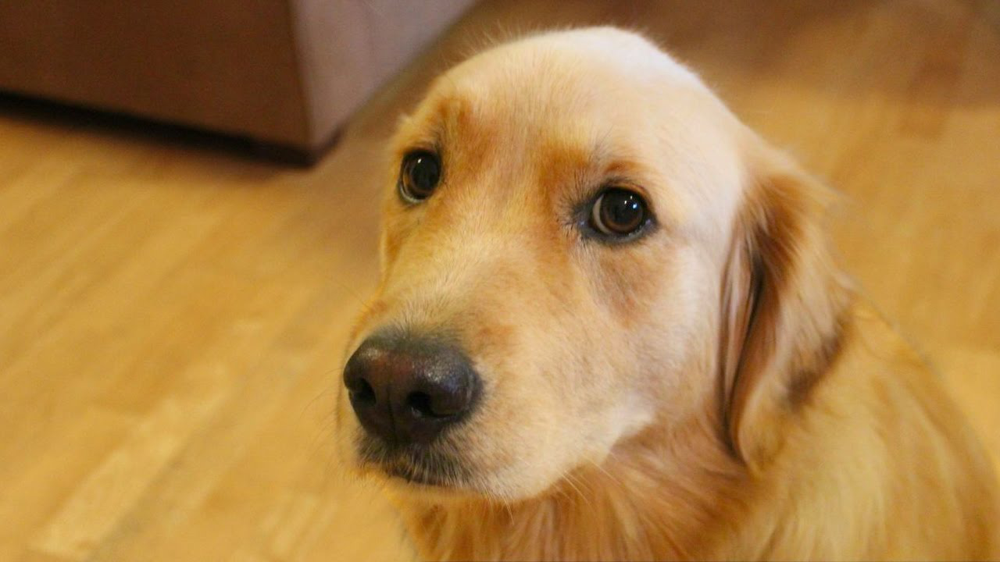

In [10]:
img_loc = f"{config['image_dir']}"
from PIL import Image
img = Image.open(img_loc + '/bobby.jpg')
img

In [11]:
img_t = preprocess(img)
import torch
batch_t = torch.unsqueeze(img_t, 0)

resnet.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [12]:
out = resnet(batch_t)
out

tensor([[-3.4803e+00, -1.6618e+00, -2.4515e+00, -3.2662e+00, -3.2466e+00,
         -1.3611e+00, -2.0465e+00, -2.5112e+00, -1.3043e+00, -2.8900e+00,
         -1.6862e+00, -1.3055e+00, -2.6129e+00, -2.9645e+00, -2.4300e+00,
         -2.8143e+00, -3.3019e+00, -7.9404e-01, -6.5182e-01, -1.2308e+00,
         -3.0193e+00, -3.9457e+00, -2.2675e+00, -1.0811e+00, -1.0232e+00,
         -1.0442e+00, -3.0918e+00, -2.4613e+00, -2.1964e+00, -3.2354e+00,
         -3.3013e+00, -1.8553e+00, -2.0921e+00, -2.1327e+00, -1.9102e+00,
         -3.2403e+00, -1.1396e+00, -1.0925e+00, -1.2186e+00, -9.3332e-01,
         -4.5093e-01, -1.5489e+00,  1.4161e+00,  1.0871e-01, -1.8442e+00,
         -1.4806e+00,  9.6227e-01, -9.9456e-01, -3.0060e+00, -2.7384e+00,
         -2.5798e+00, -2.0666e+00, -1.8022e+00, -1.9328e+00, -1.7726e+00,
         -1.3041e+00, -4.5848e-01, -2.0537e+00, -3.2804e+00, -5.0451e-01,
         -3.8174e-01, -1.1147e+00, -7.3998e-01, -1.4299e+00, -1.4883e+00,
         -2.1073e+00, -1.7373e+00, -4.

In [13]:
with open(img_loc + '/imagenet_classes.txt') as f:
    labels = [line.strip() for line in f.readlines()]

In [14]:
_, index = torch.max(out, 1)
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('golden retriever', 96.29334259033203)

In [15]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]
 

[('golden retriever', 96.29334259033203),
 ('Labrador retriever', 2.80812668800354),
 ('cocker spaniel, English cocker spaniel, cocker', 0.28267428278923035),
 ('redbone', 0.20863059163093567),
 ('tennis ball', 0.11621591448783875)]

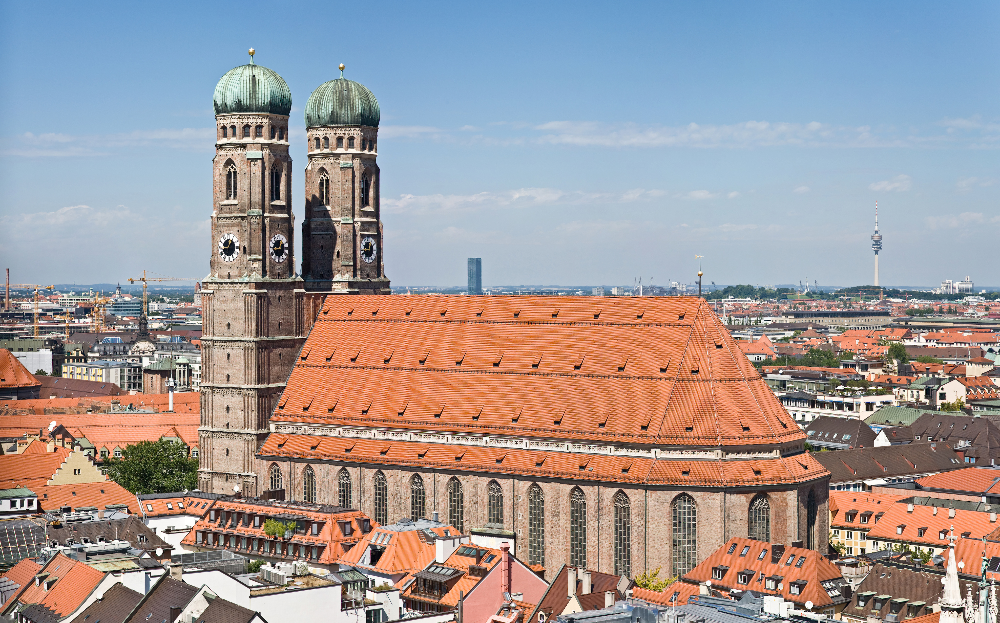

In [37]:
import requests
from io import BytesIO

url = "https://upload.wikimedia.org/wikipedia/commons/d/da/Frauenkirche_Munich_-_View_from_Peterskirche_Tower2.jpg"

headers = {
    "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) "
                  "AppleWebKit/537.36 (KHTML, like Gecko) "
                  "Chrome/115.0 Safari/537.36"
}

response = requests.get(url, headers=headers)
response.raise_for_status()
img_muc = Image.open(BytesIO(response.content))

img_muc

In [41]:
img_t = preprocess(img_muc)
import torch
batch_t = torch.unsqueeze(img_t, 0)

resnet.eval()
out = resnet(batch_t)
out

tensor([[-3.7010e+00, -6.7661e-01, -1.1278e-01, -1.9933e+00, -2.3982e+00,
         -3.0833e+00, -1.1441e+00, -1.3031e-01,  1.8040e-02,  1.9896e-01,
         -1.5623e-01, -1.4438e+00,  1.4623e+00,  1.2846e-01, -4.7239e-01,
          6.0060e-02,  2.8213e-01,  1.0890e+00,  9.7779e-01, -8.3404e-02,
         -3.0362e+00,  1.9312e+00, -3.3563e-01,  1.1610e+00, -6.7625e-01,
         -3.0634e+00, -2.3001e+00, -6.6598e-01, -2.3988e+00, -2.6925e+00,
         -2.0331e+00, -2.3158e+00, -1.5162e+00, -8.6905e-01, -1.4740e+00,
          1.2137e-01,  1.3821e+00, -8.8968e-02, -7.0961e-01, -1.8302e+00,
         -1.5959e+00,  1.4226e-01,  3.3896e-01, -2.6963e+00, -1.8604e+00,
          3.8779e-01, -1.6346e+00, -1.3666e+00, -4.2585e+00, -6.4503e-01,
         -2.1691e+00, -2.3469e+00, -1.1049e-01,  5.0265e-01,  1.9286e+00,
         -1.9190e+00, -1.6238e-01, -3.2046e-01, -3.0910e-01, -7.0691e-01,
          1.1927e+00, -2.1509e-01, -8.6449e-01, -1.0242e+00,  2.2134e-01,
         -2.8284e+00,  1.4154e-02, -1.

In [42]:
with open(img_loc + '/imagenet_classes.txt') as f:
    labels = [line.strip() for line in f.readlines()]

_, index = torch.max(out, 1)
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('tile roof', 93.27900695800781),
 ('dome', 6.038455486297607),
 ('bell cote, bell cot', 0.26341354846954346),
 ('church, church building', 0.1326105147600174),
 ('palace', 0.10477787256240845)]

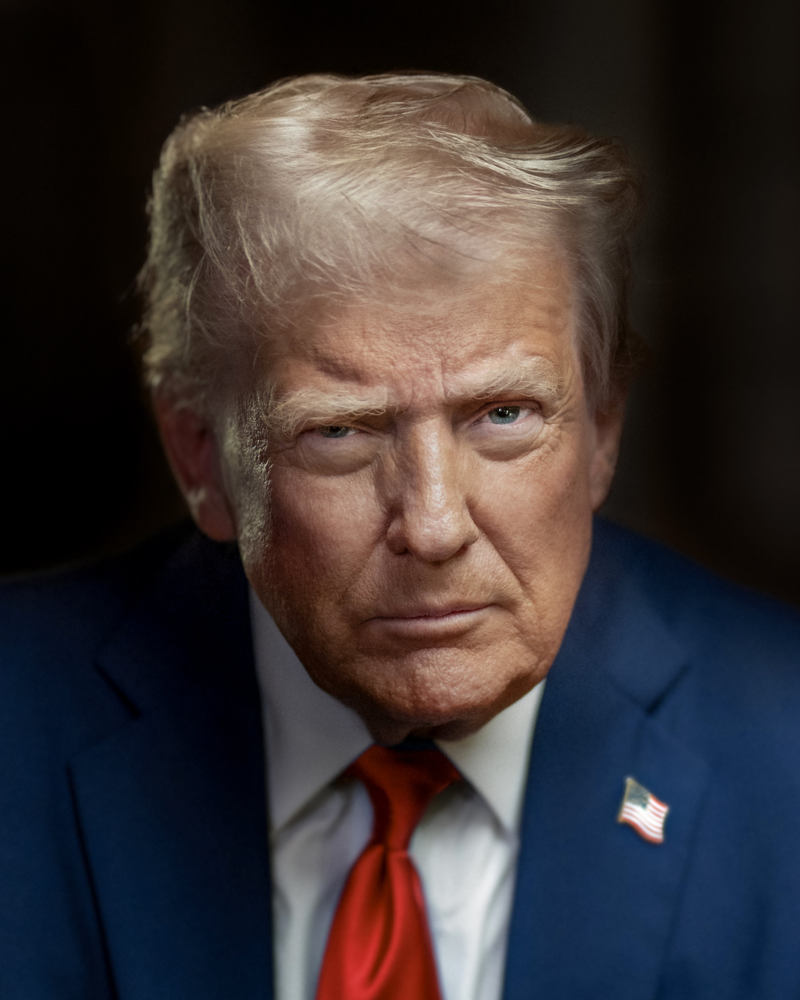

In [43]:
url_trump = "https://upload.wikimedia.org/wikipedia/commons/1/16/Official_Presidential_Portrait_of_President_Donald_J._Trump_%282025%29.jpg"

headers = {
    "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) "
                  "AppleWebKit/537.36 (KHTML, like Gecko) "
                  "Chrome/115.0 Safari/537.36"
}

response = requests.get(url_trump, headers=headers)
response.raise_for_status()
img_trump = Image.open(BytesIO(response.content))

img_trump

In [45]:
img_t = preprocess(img_trump)
import torch
batch_t = torch.unsqueeze(img_t, 0)

out = resnet(batch_t)

with open(img_loc + '/imagenet_classes.txt') as f:
    labels = [line.strip() for line in f.readlines()]

_, index = torch.max(out, 1)
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]


[('suit, suit of clothes', 52.54074478149414),
 ('Windsor tie', 40.95676040649414),
 ('bolo tie, bolo, bola tie, bola', 2.2614383697509766),
 ('groom, bridegroom', 1.6494054794311523),
 ('bow tie, bow-tie, bowtie', 0.6309719085693359)]

In [59]:
import torch
import clip
from PIL import Image

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

text = clip.tokenize(["Donald Trump", "Joe Biden", "a man in a suit"]).to(device)

with torch.no_grad():
    image_features = model.encode_image(batch_t)
    text_features = model.encode_text(text)

    logits_per_image, _ = model(batch_t, text)
    probs = logits_per_image.softmax(dim=-1).cpu().numpy()

print(probs)


[[0.97781485 0.00197979 0.02020545]]
